# Importing Packages

In [2]:
from matplotlib import gridspec
import matplotlib.pylab as plt
import numpy as np
import tensorflow as tf
import tensorflow_hub as tf_hub
import PIL

# How to Load an Image

In [10]:
def load_image(image_path, image_size=(2048, 1024)):
    img = tf.io.decode_image(
      tf.io.read_file(image_path),
      channels=3, dtype=tf.float32)[tf.newaxis, ...]
    img = tf.image.resize(img, image_size, preserve_aspect_ratio=True)
    return img

In [4]:
def visualize(images, titles=('',)):
    noi = len(images)
    image_sizes = [image.shape[1] for image in images]
    w = (image_sizes[0] * 6) // 320
    plt.figure(figsize=(w  * noi, w))
    grid_look = gridspec.GridSpec(1, noi, width_ratios=image_sizes)
    
    for i in range(noi):
        plt.subplot(grid_look[i])
        plt.imshow(images[i][0], aspect='equal')
        plt.axis('off')
        plt.title(titles[i])
        plt.savefig("final.jpg")
    plt.show()

In [5]:
original_image = load_image("warhol_1.jpg")

style_image = load_image("warhol_1.jpg")

In [18]:
print('The rank of our tensor:', np.ndim(style_image))

The rank of our tensor: 4


We've classified the rank here, which is useful in defining the parameters of our CNN pooling layers. Note that I've used $np.ndim$ instead of $tf.rank$

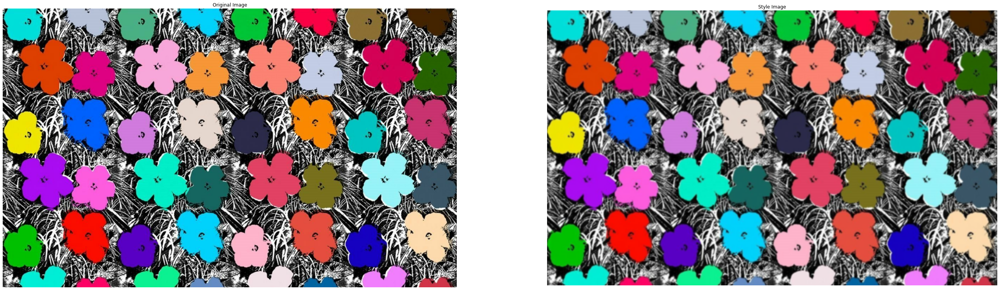

In [22]:
style_image = tf.nn.avg_pool(style_image, ksize=[6], strides=[1], padding='VALID')
visualize([original_image, style_image], ['Original Image', 'Style Image'])

In [7]:
stylize_model = tf_hub.load('arbitrary_im')

# Exploring ksize

In [27]:
style_image_kn1 = tf.nn.avg_pool(style_image, ksize=[1], strides=[1], padding='VALID')
style_image_kn2 = tf.nn.avg_pool(style_image, ksize=[1,1], strides=[1], padding='VALID')
style_image_kn4 = tf.nn.avg_pool(style_image, ksize=[1,1,1,1], strides=[1], padding='VALID')

style_image_k1 = tf.nn.avg_pool(style_image, ksize=[1,1], strides=[1], padding='VALID')
style_image_k3 = tf.nn.avg_pool(style_image, ksize=[3,3], strides=[1], padding='VALID')
style_image_k6 = tf.nn.avg_pool(style_image, ksize=[6,6], strides=[1], padding='VALID')

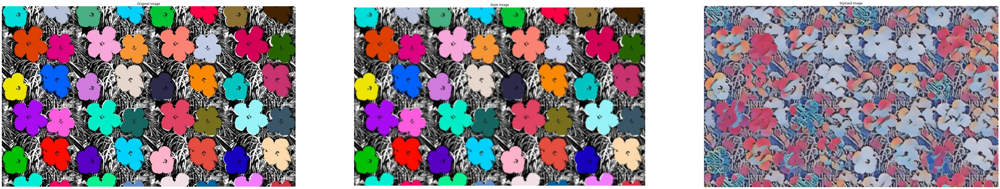

In [28]:
results = stylize_model(tf.constant(original_image), tf.constant(style_image_kn1))
stylized_photo = results[0]
visualize([original_image, style_image, stylized_photo], titles=['Original Image', 'Style Image', 'Stylized Image'])

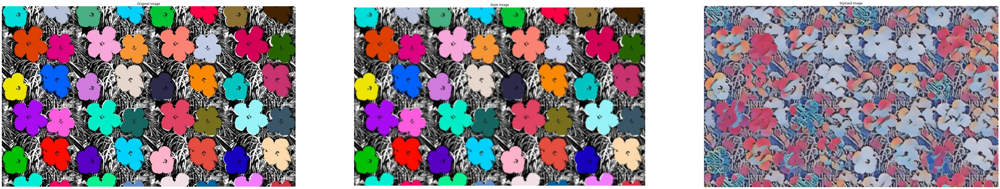

In [29]:
results = stylize_model(tf.constant(original_image), tf.constant(style_image_kn2))
stylized_photo = results[0]
visualize([original_image, style_image, stylized_photo], titles=['Original Image', 'Style Image', 'Stylized Image'])

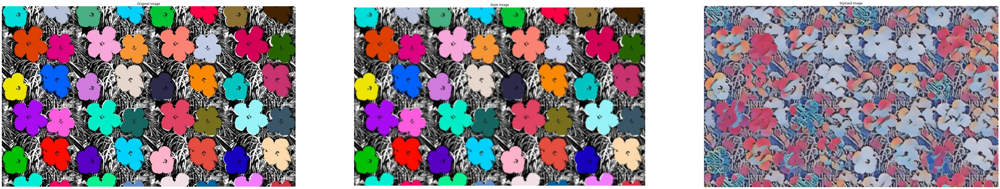

In [30]:
results = stylize_model(tf.constant(original_image), tf.constant(style_image_kn4))
stylized_photo = results[0]
visualize([original_image, style_image, stylized_photo], titles=['Original Image', 'Style Image', 'Stylized Image'])

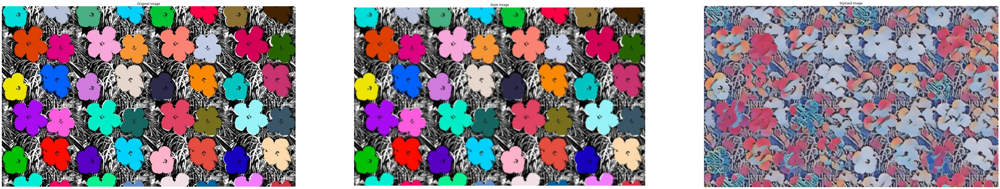

In [31]:
results = stylize_model(tf.constant(original_image), tf.constant(style_image_k1))
stylized_photo = results[0]
visualize([original_image, style_image, stylized_photo], titles=['Original Image', 'Style Image', 'Stylized Image'])

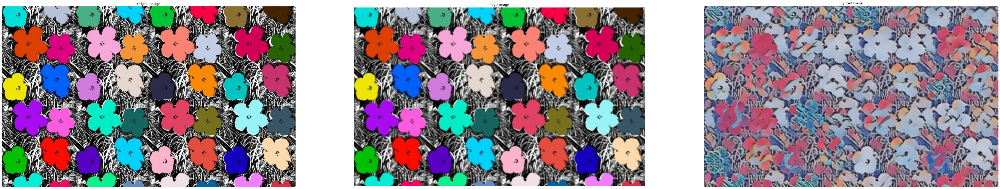

In [32]:
results = stylize_model(tf.constant(original_image), tf.constant(style_image_k3))
stylized_photo = results[0]
visualize([original_image, style_image, stylized_photo], titles=['Original Image', 'Style Image', 'Stylized Image'])

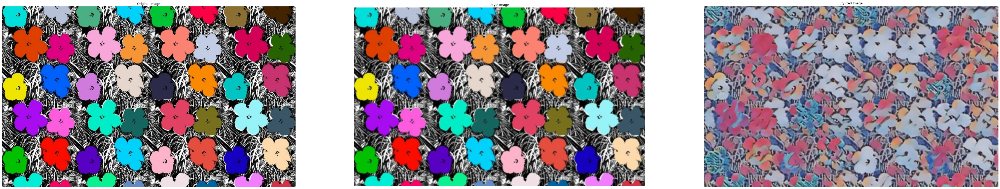

In [33]:
results = stylize_model(tf.constant(original_image), tf.constant(style_image_k6))
stylized_photo = results[0]
visualize([original_image, style_image, stylized_photo], titles=['Original Image', 'Style Image', 'Stylized Image'])

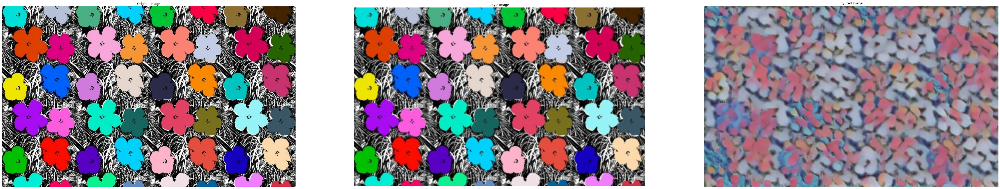

In [34]:
style_image_k18 = tf.nn.avg_pool(style_image, ksize=[18,18], strides=[1], padding='VALID')

results = stylize_model(tf.constant(original_image), tf.constant(style_image_k18))
stylized_photo = results[0]
visualize([original_image, style_image, stylized_photo], titles=['Original Image', 'Style Image', 'Stylized Image'])

We can see that our average pool algorithm definitely blends the colors and is (at the moment) not doing a great job of differentiating between colors. For this Warhol painting, there has to be a balance between retaining some level of detail without overdoing it and not blending the colors too much. With this parameter, a lower k-value retains more detail, and doesn't blend the colors as much, while a higher k-value does the opposite.

This painting is unique in that colorful areas are clustered in specific aspects of the painting, having their own unoque structure, while the colorless background is much more detailed and has its own unique structure.

It could be worth exploring how to learn the structures of the "background" and foreground" separately, then overlaying them to create a generalized output of this painting.

# Exploring Different Stride Values

# The Effects of Padding

# Exporting Our Pooled Image

In [102]:
def export_image(tf_img):
    tf_img = tf_img*255
    tf_img = np.array(tf_img, dtype=np.uint8)
    if np.ndim(tf_img)>3:
        assert tf_img.shape[0] == 1
        img = tf_img[0]
    return PIL.Image.fromarray(img)

In [128]:
export_image(stylized_photo).save("more_war_and_pollock_final.jpg")